In [59]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import torch
from torch import nn
import os

In [60]:
df = pd.read_csv("fmnist_small.csv")

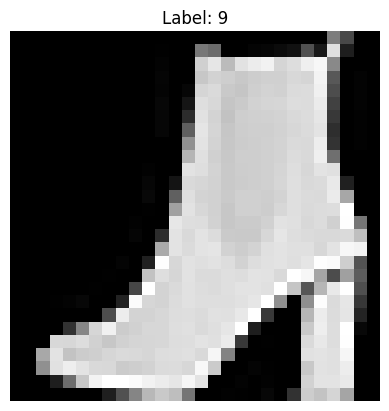

In [61]:
plt.imshow(df.iloc[0, 1:].values.reshape(28, 28), cmap='gray')
plt.title(f"Label: {df.iloc[0, 0]}")
plt.axis('off')
plt.show()

In [62]:
df.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
0,9,0,0,0,0,0,0,0,0,0,...,0,7,0,50,205,196,213,165,0,0
1,7,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,1,0,0,0,...,142,142,142,21,0,3,0,0,0,0
3,8,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,8,0,0,0,0,0,0,0,0,0,...,213,203,174,151,188,10,0,0,0,0


In [63]:
df.shape

(6000, 785)

In [64]:
# train_test split
x = df.iloc[:, 1:].values
y = df.iloc[:, 0].values

In [65]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [66]:
# scaling
X_train = X_train / 255.0
X_test = X_test / 255.0

In [67]:
np.set_printoptions(threshold=np.inf)
print(X_train)

[[0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.   

In [68]:
y_train

array([7, 6, 7, 6, 8, 2, 0, 8, 2, 7, 3, 6, 0, 9, 2, 1, 1, 7, 6, 7, 2, 8,
       5, 3, 3, 7, 2, 0, 7, 5, 0, 2, 5, 0, 8, 4, 1, 3, 2, 7, 0, 4, 7, 4,
       9, 9, 9, 5, 6, 8, 8, 7, 5, 9, 5, 2, 2, 7, 2, 6, 9, 9, 2, 3, 3, 6,
       1, 6, 3, 8, 0, 4, 5, 3, 9, 3, 3, 5, 5, 4, 1, 3, 9, 8, 8, 4, 9, 8,
       9, 3, 6, 3, 7, 1, 4, 0, 1, 4, 3, 0, 2, 7, 0, 3, 3, 8, 3, 4, 4, 6,
       4, 0, 8, 7, 6, 0, 6, 6, 6, 6, 2, 4, 2, 6, 2, 7, 6, 7, 3, 4, 2, 4,
       3, 9, 9, 2, 1, 9, 4, 8, 6, 3, 2, 0, 2, 2, 4, 5, 7, 9, 4, 8, 8, 8,
       4, 9, 3, 1, 9, 9, 9, 5, 9, 8, 4, 5, 9, 5, 6, 5, 9, 5, 2, 6, 4, 2,
       1, 6, 5, 5, 9, 4, 1, 8, 9, 4, 2, 8, 3, 5, 6, 8, 7, 6, 6, 0, 7, 7,
       6, 6, 6, 1, 3, 4, 7, 4, 8, 6, 1, 2, 5, 4, 5, 2, 6, 9, 4, 4, 0, 0,
       9, 1, 6, 8, 4, 2, 2, 9, 0, 0, 0, 1, 3, 5, 9, 1, 5, 2, 4, 3, 1, 6,
       2, 2, 2, 7, 3, 1, 4, 2, 2, 6, 2, 8, 7, 7, 2, 8, 0, 9, 9, 9, 9, 1,
       1, 0, 3, 3, 0, 3, 7, 4, 7, 1, 5, 1, 2, 2, 7, 1, 8, 9, 5, 0, 8, 9,
       9, 6, 1, 7, 5, 2, 2, 0, 1, 3, 8, 6, 4, 8, 4,

In [75]:
# Build a PyTorch Dataset + DataLoader
# Build a PyTorch Dataset + DataLoader
class FashionDataset(torch.utils.data.Dataset):
    def __init__(self, features, labels):
        self.features = torch.tensor(features, dtype=torch.float32)
        self.labels = torch.tensor(labels, dtype=torch.long)

    def __len__(self):
        return len(self.features)

    def __getitem__(self, index):
        return self.features[index], self.labels[index]


train_dataset = FashionDataset(X_train, y_train)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)

In [80]:
# define ann model
class ANNModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(ANNModel, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        out = self.fc1(x)
        out = self.relu(out)
        out = self.fc2(out)
        return out


model = ANNModel(input_size=784, hidden_size=128, output_size=10)

        

In [81]:
# Choose loss + optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr = 0.001)

In [82]:
# training loop
num_epochs = 5

for epoch in range(num_epochs):
    running_loss = 0.0

    for inputs, labels in train_loader:
        # forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        # backward pass + optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch [{epoch+1}/{num_epochs}]  Loss: {running_loss/len(train_loader):.4f}")


Epoch [1/5]  Loss: 0.9850
Epoch [2/5]  Loss: 0.6187
Epoch [2/5]  Loss: 0.6187
Epoch [3/5]  Loss: 0.5426
Epoch [3/5]  Loss: 0.5426
Epoch [4/5]  Loss: 0.5021
Epoch [4/5]  Loss: 0.5021
Epoch [5/5]  Loss: 0.4613
Epoch [5/5]  Loss: 0.4613


In [83]:
# evaluate the model
model.eval()
with torch.no_grad():
    test_inputs = torch.tensor(X_test, dtype=torch.float32)
    test_labels = torch.tensor(y_test, dtype=torch.long)

    test_outputs = model(test_inputs)
    _, predicted = torch.max(test_outputs.data, 1)

    total = test_labels.size(0)
    correct = (predicted == test_labels).sum().item()

    print(f"Test Accuracy: {100 * correct / total:.2f}%")

Test Accuracy: 82.75%
